In [1]:
import matplotlib.pyplot as plt
from matplotlib.image import imread
import scanpy as sc
import numpy as np
import pandas as pd
#import cv2
import math
from pathlib import Path, PurePath
from scipy.spatial import distance
from scipy.ndimage import gaussian_filter
from typing import Union, Dict, Optional, Tuple, BinaryIO
import json

from PIL import Image

In [2]:
def QC(tissue_dir):
    metafile = None
    adata1 = sc.read_visium(tissue_dir) 
    
    adata1.var_names_make_unique() 
    #sc.pp.normalize_total(adata1, inplace=True) 
    sc.pp.log1p(adata1)
    adata1.obs['n_counts'] = adata1.X.sum(axis=1).A1
    sc.pl.spatial(adata1, img_key="hires", color='n_counts', alpha=0.7, cmap='jet')

    return adata1

## chlamydia

In [7]:
tissue_dir = '/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/CRC_16_16S_rRNA_Chlamydia'
# CRC_16_human_16S_rRNA
# OSCC_Ecoli+Human
metafile = None

/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


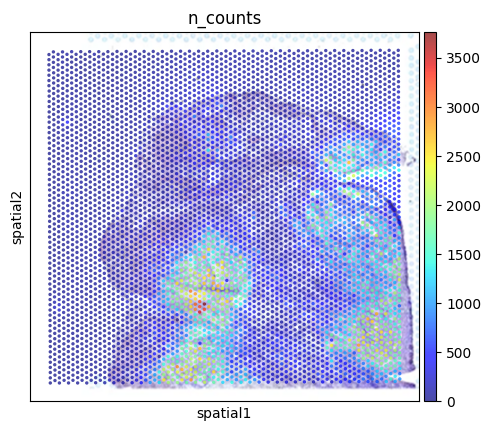

In [8]:
adata1 = QC(tissue_dir)

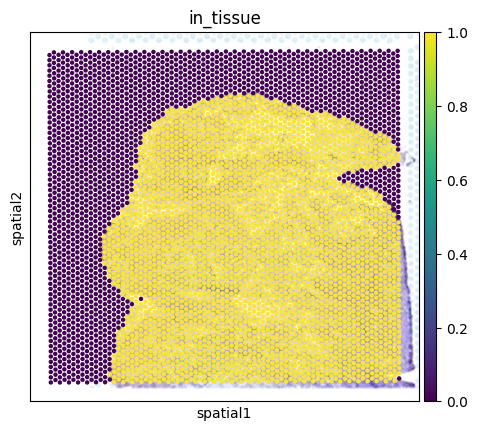

In [9]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'in_tissue'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='in_tissue', spot_size=20)


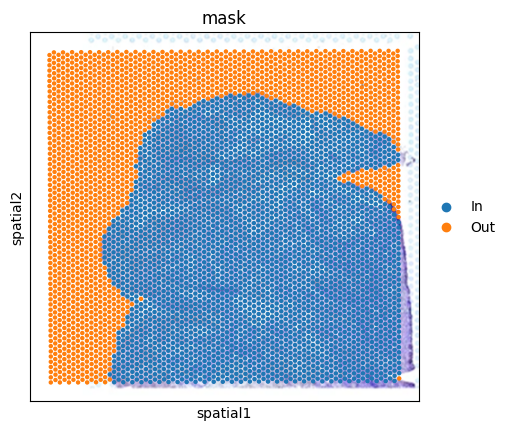

In [10]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']
adata1.obs['mask'] = adata1.obs['mask'].fillna('Out')

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'In'과 'Out'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='mask', spot_size=20)


In [11]:
adata=adata1

In [12]:
# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata.obs['in_tissue'] = adata.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)
adata.obs['in_tissue'] = adata.obs['in_tissue'].astype(int)

# 결과를 확인합니다.
print(adata.obs.head())


                    in_tissue  array_row  array_col     n_counts mask
AAACAACGAATAGTTC-1          0          0         16   186.152924  Out
AAACAAGTATCTCCCA-1          1         50        102   349.157562   In
AAACAATCTACTAGCA-1          1          3         43  1545.991211   In
AAACACCAATAACTGC-1          0         59         19    62.473984  Out
AAACAGAGCGACTCCT-1          1         14         94   341.236755   In


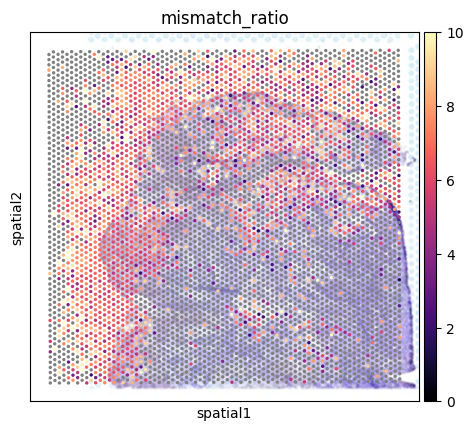

In [13]:
df = pd.read_csv('/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/barcode_summary_Chlamydia.csv', index_col = 0)

adata.obs['all_RNA_reads'] = df['l2']
adata.obs['mean_num_of_mismatches'] = df['l3']

adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']

adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.magma# You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

sc.pl.spatial(adata, color='mismatch_ratio', save = '.png', cmap=cmap,  vmax = 10, vmin=0)


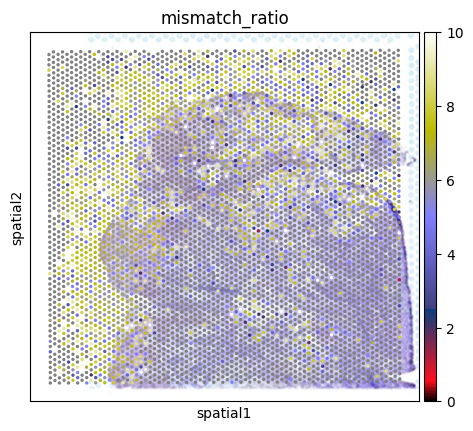

In [14]:
import matplotlib.pyplot as plt
import scanpy as sc

# Your existing code for creating the plot
adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']
adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution


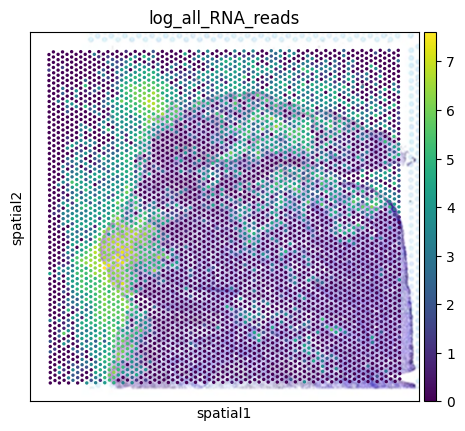

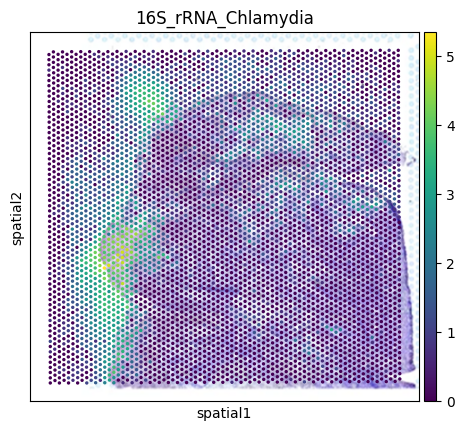

In [15]:
adata.obs['log_all_RNA_reads'] = np.log1p(adata.obs['all_RNA_reads'])
sc.pl.spatial(adata, color='log_all_RNA_reads')

sc.pl.spatial(adata, color='16S_rRNA_Chlamydia')

tissue_positions_df = pd.read_csv('~/_Nature/CRC_16_human_16S_rRNA/outs/spatial/tissue_positions_list.csv')

In [20]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# in_tissue의 총 합을 계산합니다.
total_in_tissue = adata.obs['in_tissue'].sum()

# 조건을 만족하는 최소 이웃의 수를 찾기 위한 변수를 초기화합니다.
min_neighbors = 1
condition_met = False

# 조건을 만족할 때까지 이웃의 수를 증가시키면서 반복합니다.
for n_neighbors in range(1, len(adata.obs) + 1):
    # 각 샘플에 대해 n_neighbors 만큼의 가장 가까운 이웃을 찾습니다.
    nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:n_neighbors+1]

    # 새로운 플래그를 계산합니다.
    new_flag = []
    for idx, neighbors in enumerate(nearest_neighbors_indices):
        # 이웃들의 in_tissue 값 검사
        neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
        # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
        new_flag.append(np.any(neighbor_in_tissue == 1))

    # new_flag의 총 합을 계산합니다.
    total_new_flag = np.sum(new_flag)

    # 조건이 충족되는지 검사합니다.
    if total_new_flag >= 1.2 * total_in_tissue:
        min_neighbors = n_neighbors
        condition_met = True
        break

# 결과를 출력합니다.
if condition_met:
    print(f"최소 이웃의 수: {min_neighbors}, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.")
    # 새로운 플래그를 adata.obs에 추가합니다.
    adata.obs['new_flag'] = new_flag
else:
    print("어떤 이웃의 수에서도 new_flag의 총 합이 in_tissue의 1.2 배를 초과하지 않습니다.")


최소 이웃의 수: 70, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.


In [21]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
min_neighbors = 70
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# 각 샘플에 대해 가장 가까운 3개의 이웃을 찾습니다 (자기 자신을 제외).
# argsort를 사용하여 각 행마다 거리가 가장 짧은 이웃의 인덱스를 얻습니다.
nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:(min_neighbors+1)]

# in_tissue 값을 기반으로 새로운 플래그를 생성합니다.
# 이 플래그는 주어진 샘플이 이웃 중 하나 이상이 in_tissue가 1인 경우 true로 설정됩니다.
new_flag = []
for idx, neighbors in enumerate(nearest_neighbors_indices):
    # 이웃들의 in_tissue 값 검사
    neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
    # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
    new_flag.append(np.any(neighbor_in_tissue == 1))

# 새로운 플래그를 adata.obs에 추가
adata.obs['new_flag'] = new_flag

# 결과 확인
print(adata.obs[['array_row', 'array_col', 'in_tissue', 'new_flag']].head())

# 선택적으로, spatial plot 생성
#sc.pl.spatial(filtered_adata, color='new_flag')


                    array_row  array_col  in_tissue  new_flag
AAACAACGAATAGTTC-1          0         16          0     False
AAACAAGTATCTCCCA-1         50        102          1      True
AAACAATCTACTAGCA-1          3         43          1      True
AAACACCAATAACTGC-1         59         19          0     False
AAACAGAGCGACTCCT-1         14         94          1      True


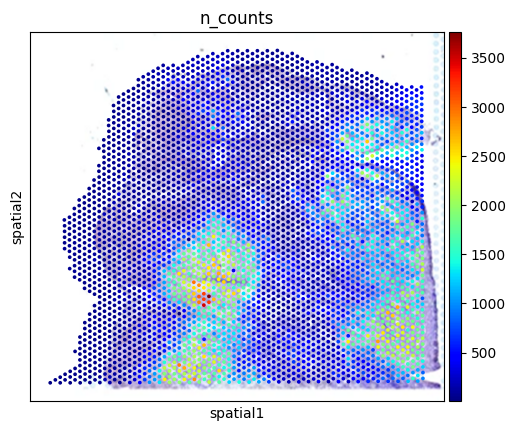

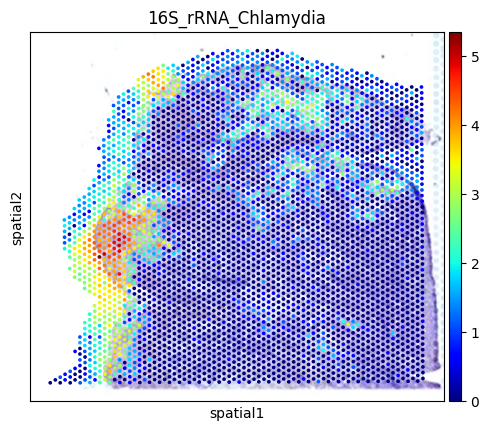

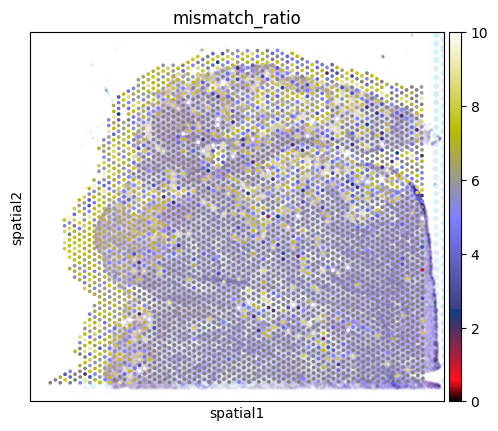

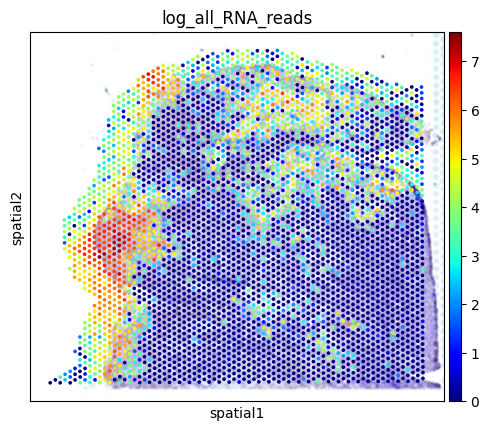

In [22]:
# 선택적으로, spatial plot 생성
# sc.pl.spatial(adata, color='new_flag')

filtered_adata = adata[adata.obs['new_flag'] == True]

sc.pl.spatial(filtered_adata, color = 'n_counts', cmap='jet')

sc.pl.spatial(filtered_adata, color = '16S_rRNA_Chlamydia', cmap='jet')

import matplotlib.pyplot as plt
import scanpy as sc

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(filtered_adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution

sc.pl.spatial(filtered_adata, color = 'log_all_RNA_reads', cmap='jet')

In [23]:
# AnnData 객체를 'adata.h5ad' 파일로 저장
adata.write('CRC_filtered_adata_240410.h5ad')


/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


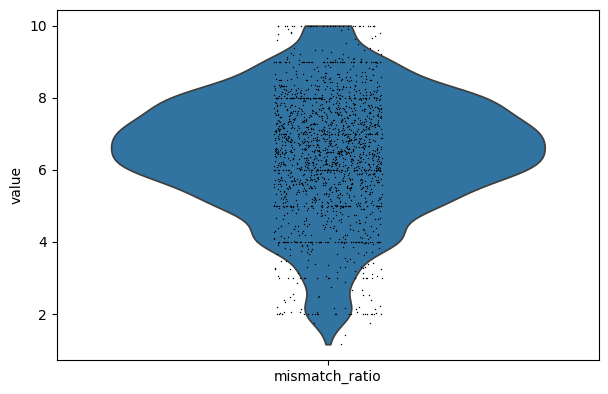

In [24]:
import scanpy as sc

# mismatch_ratio가 -1이 아닌 행만 필터링
filtered_data = filtered_adata[filtered_adata.obs['mismatch_ratio'] != -1].copy()

# 필터링된 데이터로 바이올린 플롯 그리기
sc.pl.violin(filtered_data, keys='mismatch_ratio')


## Escherichia coli

In [25]:
tissue_dir = '/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/CRC_16_16S_rRNA_Escherichia'
# CRC_16_human_16S_rRNA
# OSCC_Ecoli+Human
metafile = None

/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


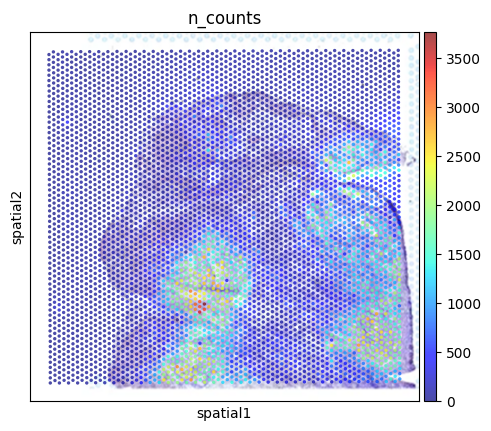

In [26]:
adata1 = QC(tissue_dir)

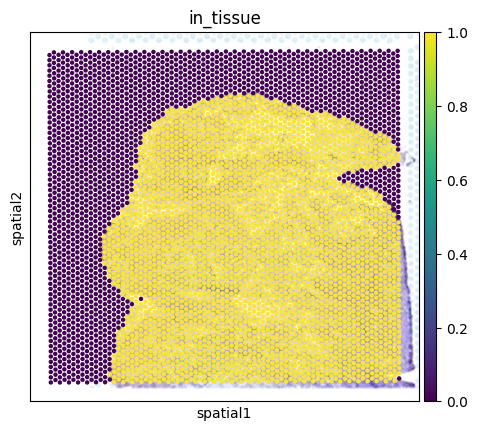

In [27]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'in_tissue'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='in_tissue', spot_size=20)


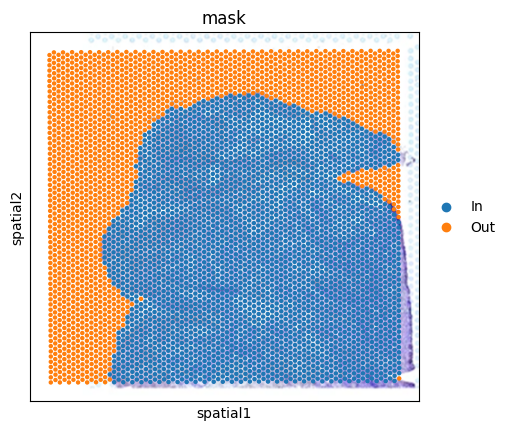

In [28]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']
adata1.obs['mask'] = adata1.obs['mask'].fillna('Out')

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'In'과 'Out'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='mask', spot_size=20)


In [29]:
adata=adata1

In [30]:
# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata.obs['in_tissue'] = adata.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)
adata.obs['in_tissue'] = adata.obs['in_tissue'].astype(int)

# 결과를 확인합니다.
print(adata.obs.head())


                    in_tissue  array_row  array_col     n_counts mask
AAACAACGAATAGTTC-1          0          0         16   186.846069  Out
AAACAAGTATCTCCCA-1          1         50        102   349.157562   In
AAACAATCTACTAGCA-1          1          3         43  1546.501953   In
AAACACCAATAACTGC-1          0         59         19    63.049351  Out
AAACAGAGCGACTCCT-1          1         14         94   341.236755   In


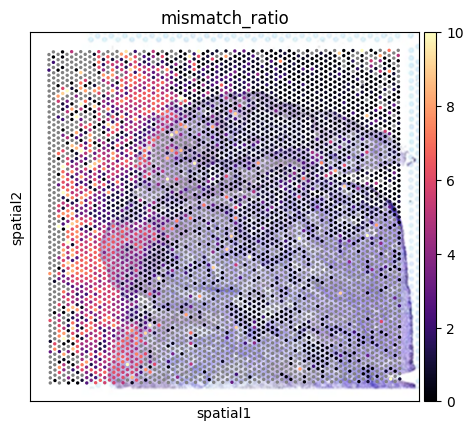

In [31]:
df = pd.read_csv('/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/barcode_summary_Escherichia.csv', index_col = 0)

adata.obs['all_RNA_reads'] = df['l2']
adata.obs['mean_num_of_mismatches'] = df['l3']

adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']

adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.magma# You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

sc.pl.spatial(adata, color='mismatch_ratio', save = '.png', cmap=cmap,  vmax = 10, vmin=0)


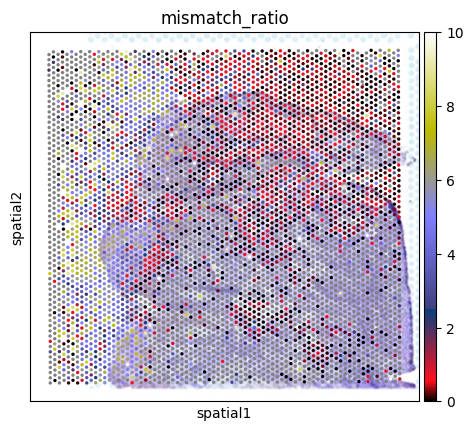

In [32]:
import matplotlib.pyplot as plt
import scanpy as sc

# Your existing code for creating the plot
adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']
adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution


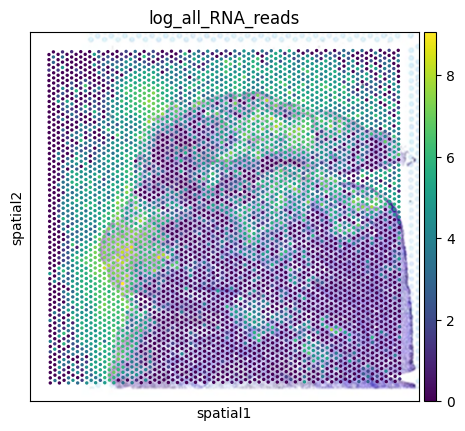

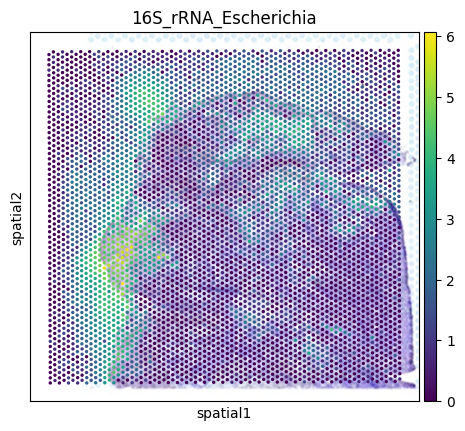

In [34]:
adata.obs['log_all_RNA_reads'] = np.log1p(adata.obs['all_RNA_reads'])
sc.pl.spatial(adata, color='log_all_RNA_reads')

sc.pl.spatial(adata, color='16S_rRNA_Escherichia')

tissue_positions_df = pd.read_csv('~/_Nature/CRC_16_human_16S_rRNA/outs/spatial/tissue_positions_list.csv')

In [35]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# in_tissue의 총 합을 계산합니다.
total_in_tissue = adata.obs['in_tissue'].sum()

# 조건을 만족하는 최소 이웃의 수를 찾기 위한 변수를 초기화합니다.
min_neighbors = 1
condition_met = False

# 조건을 만족할 때까지 이웃의 수를 증가시키면서 반복합니다.
for n_neighbors in range(1, len(adata.obs) + 1):
    # 각 샘플에 대해 n_neighbors 만큼의 가장 가까운 이웃을 찾습니다.
    nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:n_neighbors+1]

    # 새로운 플래그를 계산합니다.
    new_flag = []
    for idx, neighbors in enumerate(nearest_neighbors_indices):
        # 이웃들의 in_tissue 값 검사
        neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
        # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
        new_flag.append(np.any(neighbor_in_tissue == 1))

    # new_flag의 총 합을 계산합니다.
    total_new_flag = np.sum(new_flag)

    # 조건이 충족되는지 검사합니다.
    if total_new_flag >= 1.2 * total_in_tissue:
        min_neighbors = n_neighbors
        condition_met = True
        break

# 결과를 출력합니다.
if condition_met:
    print(f"최소 이웃의 수: {min_neighbors}, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.")
    # 새로운 플래그를 adata.obs에 추가합니다.
    adata.obs['new_flag'] = new_flag
else:
    print("어떤 이웃의 수에서도 new_flag의 총 합이 in_tissue의 1.2 배를 초과하지 않습니다.")


최소 이웃의 수: 70, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.


In [36]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
min_neighbors = 70
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# 각 샘플에 대해 가장 가까운 3개의 이웃을 찾습니다 (자기 자신을 제외).
# argsort를 사용하여 각 행마다 거리가 가장 짧은 이웃의 인덱스를 얻습니다.
nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:(min_neighbors+1)]

# in_tissue 값을 기반으로 새로운 플래그를 생성합니다.
# 이 플래그는 주어진 샘플이 이웃 중 하나 이상이 in_tissue가 1인 경우 true로 설정됩니다.
new_flag = []
for idx, neighbors in enumerate(nearest_neighbors_indices):
    # 이웃들의 in_tissue 값 검사
    neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
    # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
    new_flag.append(np.any(neighbor_in_tissue == 1))

# 새로운 플래그를 adata.obs에 추가
adata.obs['new_flag'] = new_flag

# 결과 확인
print(adata.obs[['array_row', 'array_col', 'in_tissue', 'new_flag']].head())

# 선택적으로, spatial plot 생성
#sc.pl.spatial(filtered_adata, color='new_flag')


                    array_row  array_col  in_tissue  new_flag
AAACAACGAATAGTTC-1          0         16          0     False
AAACAAGTATCTCCCA-1         50        102          1      True
AAACAATCTACTAGCA-1          3         43          1      True
AAACACCAATAACTGC-1         59         19          0     False
AAACAGAGCGACTCCT-1         14         94          1      True


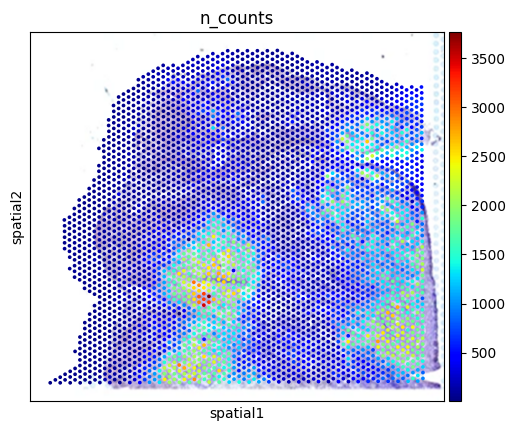

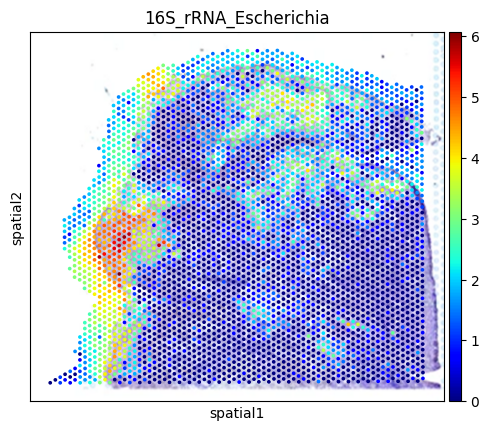

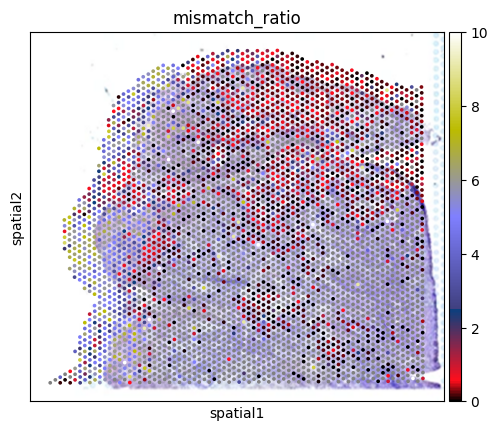

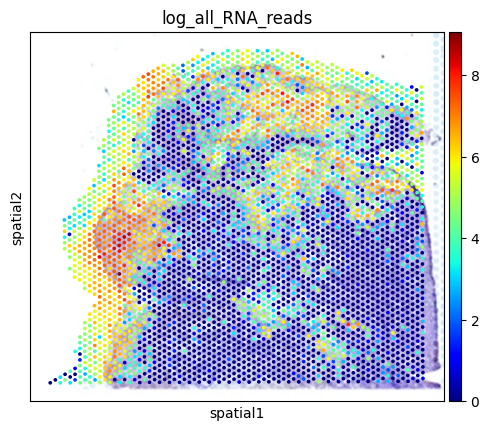

In [37]:
# 선택적으로, spatial plot 생성
# sc.pl.spatial(adata, color='new_flag')

filtered_adata = adata[adata.obs['new_flag'] == True]

sc.pl.spatial(filtered_adata, color = 'n_counts', cmap='jet')

sc.pl.spatial(filtered_adata, color = '16S_rRNA_Escherichia', cmap='jet')

import matplotlib.pyplot as plt
import scanpy as sc

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(filtered_adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution

sc.pl.spatial(filtered_adata, color = 'log_all_RNA_reads', cmap='jet')

In [38]:
# AnnData 객체를 'adata.h5ad' 파일로 저장
adata.write('CRC_filtered_adata_240410_escherichia.h5ad')


/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


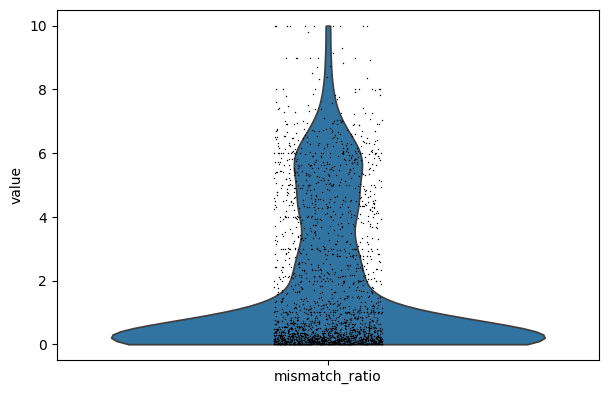

In [39]:
import scanpy as sc

# mismatch_ratio가 -1이 아닌 행만 필터링
filtered_data = filtered_adata[filtered_adata.obs['mismatch_ratio'] != -1].copy()

# 필터링된 데이터로 바이올린 플롯 그리기
sc.pl.violin(filtered_data, keys='mismatch_ratio')


## Staphilococcus

In [77]:
tissue_dir = '/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/CRC_16_16S_rRNA_Staphilococcus'
# CRC_16_human_16S_rRNA
# OSCC_Ecoli+Human
metafile = None

/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


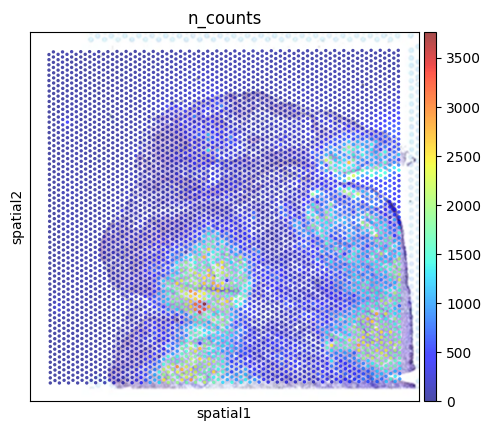

In [78]:
adata1 = QC(tissue_dir)

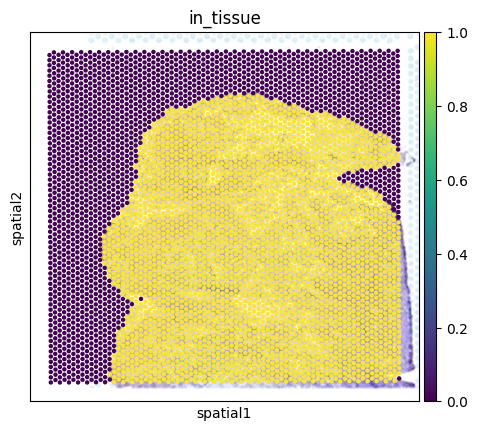

In [79]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'in_tissue'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='in_tissue', spot_size=20)


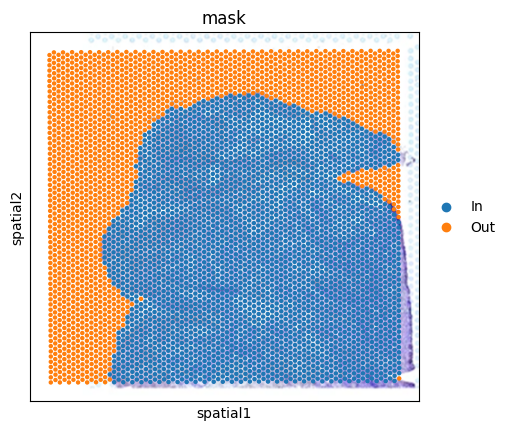

In [80]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']
adata1.obs['mask'] = adata1.obs['mask'].fillna('Out')

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'In'과 'Out'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='mask', spot_size=20)


In [81]:
adata=adata1

In [82]:
# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata.obs['in_tissue'] = adata.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)
adata.obs['in_tissue'] = adata.obs['in_tissue'].astype(int)

# 결과를 확인합니다.
print(adata.obs.head())


                    in_tissue  array_row  array_col     n_counts mask
AAACAACGAATAGTTC-1          0          0         16   185.459778  Out
AAACAAGTATCTCCCA-1          1         50        102   349.157562   In
AAACAATCTACTAGCA-1          1          3         43  1545.991211   In
AAACACCAATAACTGC-1          0         59         19    63.138962  Out
AAACAGAGCGACTCCT-1          1         14         94   341.236755   In


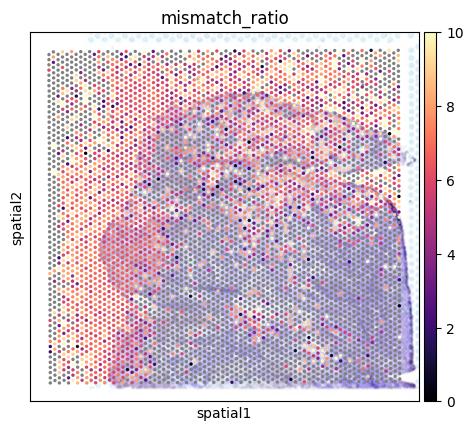

In [83]:
df = pd.read_csv('/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/barcode_summary_Staphilococcus.csv', index_col = 0)

adata.obs['all_RNA_reads'] = df['l2']
adata.obs['mean_num_of_mismatches'] = df['l3']

adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']

adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.magma# You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

sc.pl.spatial(adata, color='mismatch_ratio', save = '.png', cmap=cmap,  vmax = 10, vmin=0)


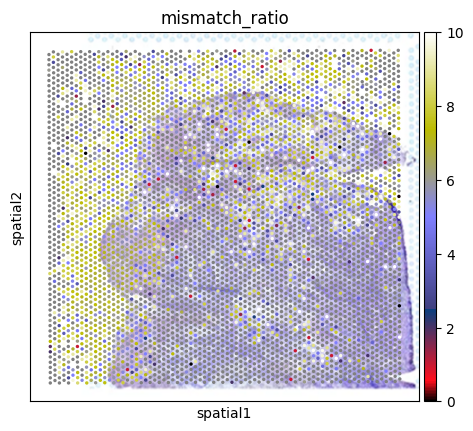

In [84]:
import matplotlib.pyplot as plt
import scanpy as sc

# Your existing code for creating the plot
adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']
adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution


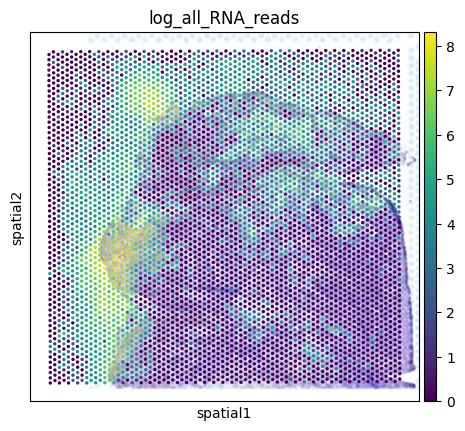

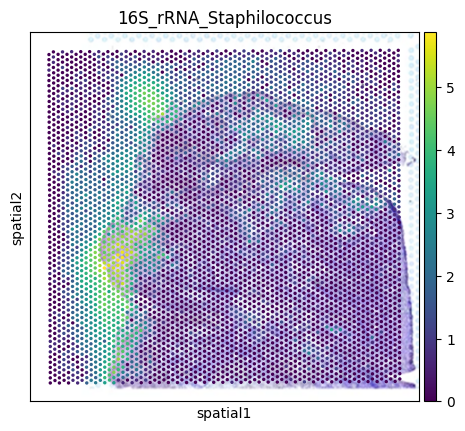

In [85]:
adata.obs['log_all_RNA_reads'] = np.log1p(adata.obs['all_RNA_reads'])
sc.pl.spatial(adata, color='log_all_RNA_reads')

sc.pl.spatial(adata, color='16S_rRNA_Staphilococcus')

tissue_positions_df = pd.read_csv('~/_Nature/CRC_16_human_16S_rRNA/outs/spatial/tissue_positions_list.csv')

In [86]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# in_tissue의 총 합을 계산합니다.
total_in_tissue = adata.obs['in_tissue'].sum()

# 조건을 만족하는 최소 이웃의 수를 찾기 위한 변수를 초기화합니다.
min_neighbors = 1
condition_met = False

# 조건을 만족할 때까지 이웃의 수를 증가시키면서 반복합니다.
for n_neighbors in range(1, len(adata.obs) + 1):
    # 각 샘플에 대해 n_neighbors 만큼의 가장 가까운 이웃을 찾습니다.
    nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:n_neighbors+1]

    # 새로운 플래그를 계산합니다.
    new_flag = []
    for idx, neighbors in enumerate(nearest_neighbors_indices):
        # 이웃들의 in_tissue 값 검사
        neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
        # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
        new_flag.append(np.any(neighbor_in_tissue == 1))

    # new_flag의 총 합을 계산합니다.
    total_new_flag = np.sum(new_flag)

    # 조건이 충족되는지 검사합니다.
    if total_new_flag >= 1.2 * total_in_tissue:
        min_neighbors = n_neighbors
        condition_met = True
        break

# 결과를 출력합니다.
if condition_met:
    print(f"최소 이웃의 수: {min_neighbors}, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.")
    # 새로운 플래그를 adata.obs에 추가합니다.
    adata.obs['new_flag'] = new_flag
else:
    print("어떤 이웃의 수에서도 new_flag의 총 합이 in_tissue의 1.2 배를 초과하지 않습니다.")


최소 이웃의 수: 70, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.


In [87]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
min_neighbors = 70
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# 각 샘플에 대해 가장 가까운 3개의 이웃을 찾습니다 (자기 자신을 제외).
# argsort를 사용하여 각 행마다 거리가 가장 짧은 이웃의 인덱스를 얻습니다.
nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:(min_neighbors+1)]

# in_tissue 값을 기반으로 새로운 플래그를 생성합니다.
# 이 플래그는 주어진 샘플이 이웃 중 하나 이상이 in_tissue가 1인 경우 true로 설정됩니다.
new_flag = []
for idx, neighbors in enumerate(nearest_neighbors_indices):
    # 이웃들의 in_tissue 값 검사
    neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
    # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
    new_flag.append(np.any(neighbor_in_tissue == 1))

# 새로운 플래그를 adata.obs에 추가
adata.obs['new_flag'] = new_flag

# 결과 확인
print(adata.obs[['array_row', 'array_col', 'in_tissue', 'new_flag']].head())

# 선택적으로, spatial plot 생성
#sc.pl.spatial(filtered_adata, color='new_flag')


                    array_row  array_col  in_tissue  new_flag
AAACAACGAATAGTTC-1          0         16          0     False
AAACAAGTATCTCCCA-1         50        102          1      True
AAACAATCTACTAGCA-1          3         43          1      True
AAACACCAATAACTGC-1         59         19          0     False
AAACAGAGCGACTCCT-1         14         94          1      True


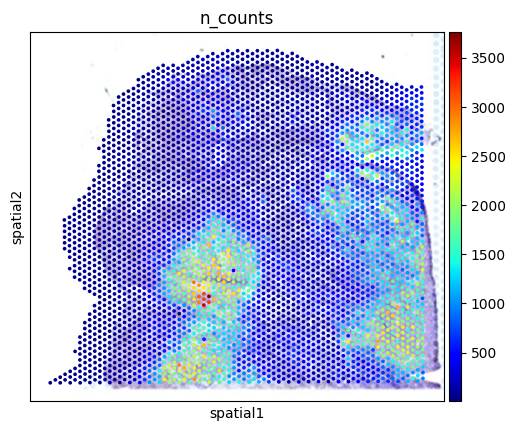

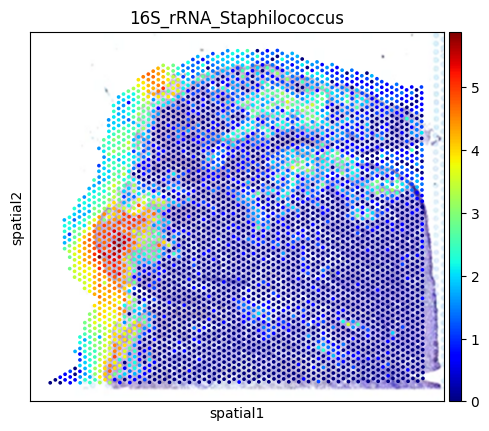

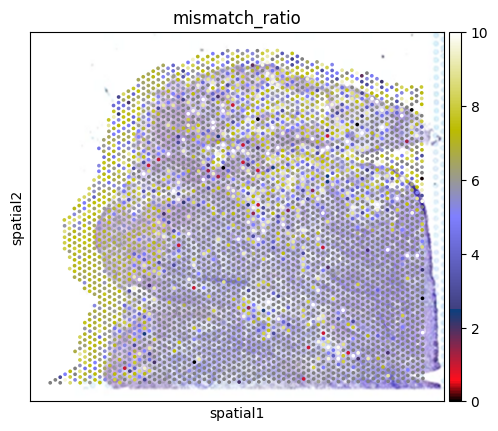

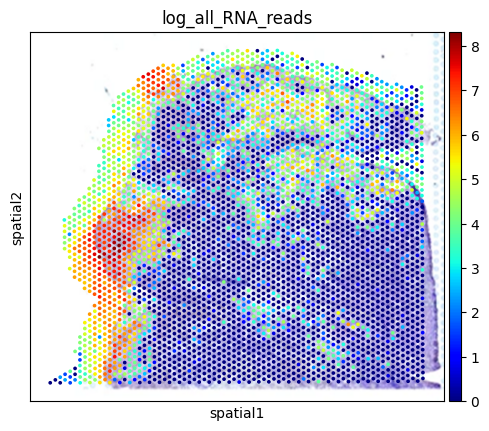

In [89]:
# 선택적으로, spatial plot 생성
# sc.pl.spatial(adata, color='new_flag')

filtered_adata = adata[adata.obs['new_flag'] == True]

sc.pl.spatial(filtered_adata, color = 'n_counts', cmap='jet')

sc.pl.spatial(filtered_adata, color = '16S_rRNA_Staphilococcus', cmap='jet')

import matplotlib.pyplot as plt
import scanpy as sc

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(filtered_adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution

sc.pl.spatial(filtered_adata, color = 'log_all_RNA_reads', cmap='jet')

In [52]:
# AnnData 객체를 'adata.h5ad' 파일로 저장
adata.write('CRC_filtered_adata_240410_staphilococcus.h5ad')


/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


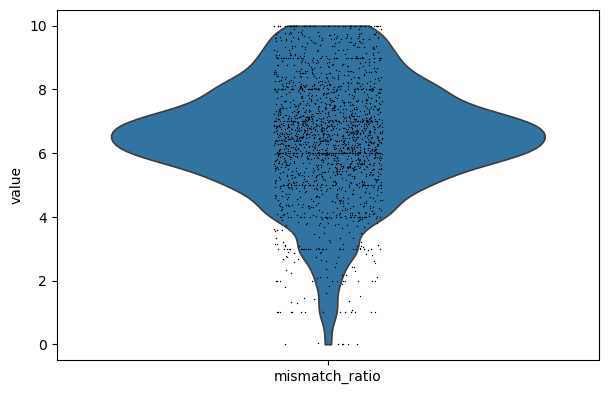

In [90]:
import scanpy as sc

# mismatch_ratio가 -1이 아닌 행만 필터링
filtered_data = filtered_adata[filtered_adata.obs['mismatch_ratio'] != -1].copy()

# 필터링된 데이터로 바이올린 플롯 그리기
sc.pl.violin(filtered_data, keys='mismatch_ratio')


## Staphylococcus

In [91]:
tissue_dir = '/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/CRC_16_16S_rRNA_Staphylococcus'
# CRC_16_human_16S_rRNA
# OSCC_Ecoli+Human
metafile = None

/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


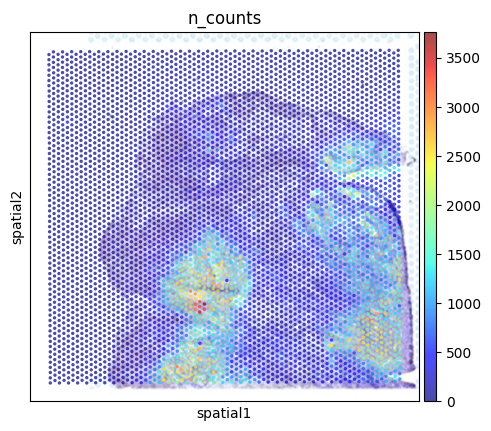

In [92]:
adata1 = QC(tissue_dir)

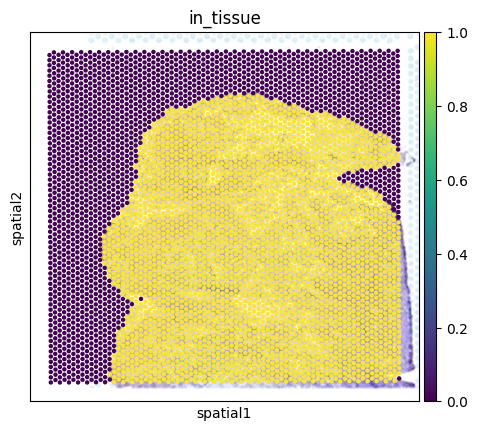

In [93]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'in_tissue'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='in_tissue', spot_size=20)


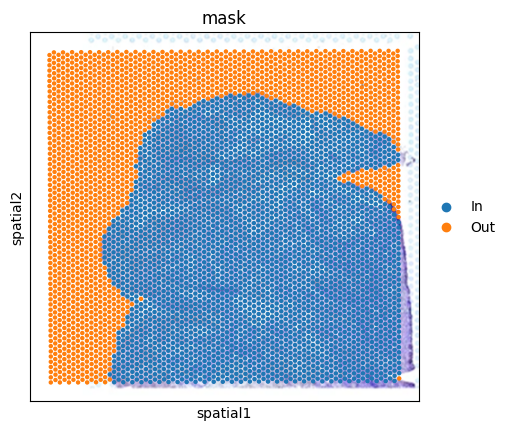

In [94]:
import pandas as pd
import scanpy as sc

# CRC_mask.csv 파일 읽기
mask_df = pd.read_csv('./CRC_16_human_16S_rRNA/outs/CRC_mask.csv', index_col=0)

# adata1.obs에 mask 정보 추가하기
adata1.obs['mask'] = mask_df['mask_in']
adata1.obs['mask'] = adata1.obs['mask'].fillna('Out')

# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata1.obs['in_tissue'] = adata1.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)

# Spatial plot 그리기, 'In'과 'Out'에 따라 색상을 다르게 지정
sc.pl.spatial(adata1, color='mask', spot_size=20)


In [95]:
adata = adata1

In [96]:
# 'in_tissue' 열에서 'In'은 1로, 'Out'은 0으로 매핑합니다.
adata.obs['in_tissue'] = adata.obs['mask'].apply(lambda x: 1 if x == 'In' else 0)
adata.obs['in_tissue'] = adata.obs['in_tissue'].astype(int)

# 결과를 확인합니다.
print(adata.obs.head())


                    in_tissue  array_row  array_col     n_counts mask
AAACAACGAATAGTTC-1          0          0         16   185.459778  Out
AAACAAGTATCTCCCA-1          1         50        102   349.157562   In
AAACAATCTACTAGCA-1          1          3         43  1545.991211   In
AAACACCAATAACTGC-1          0         59         19    63.049351  Out
AAACAGAGCGACTCCT-1          1         14         94   341.236755   In


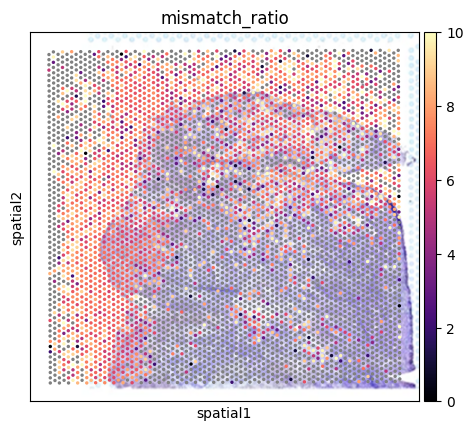

In [97]:
df = pd.read_csv('/home/seohyepark/portrai-nadim/2831300_Tumor_microbiome/CRC/barcode_summary_Staphylococcus.csv', index_col = 0)

adata.obs['all_RNA_reads'] = df['l2']
adata.obs['mean_num_of_mismatches'] = df['l3']

adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']

adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.magma# You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

sc.pl.spatial(adata, color='mismatch_ratio', save = '.png', cmap=cmap,  vmax = 10, vmin=0)


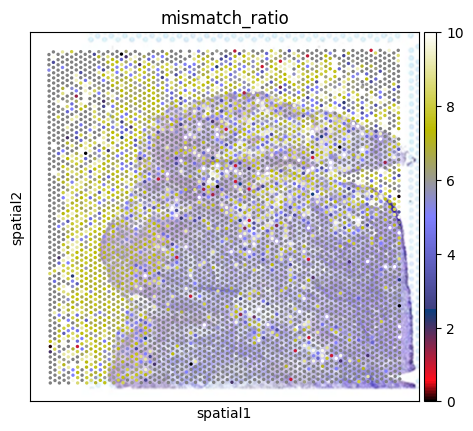

In [98]:
import matplotlib.pyplot as plt
import scanpy as sc

# Your existing code for creating the plot
adata.obs['mismatch_ratio'] = adata.obs['mean_num_of_mismatches'] / adata.obs['all_RNA_reads']
adata.obs['mismatch_ratio'].replace([np.inf, -np.inf], np.nan, inplace=True)
adata.obs['mismatch_ratio'].fillna(-1, inplace=True)

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution


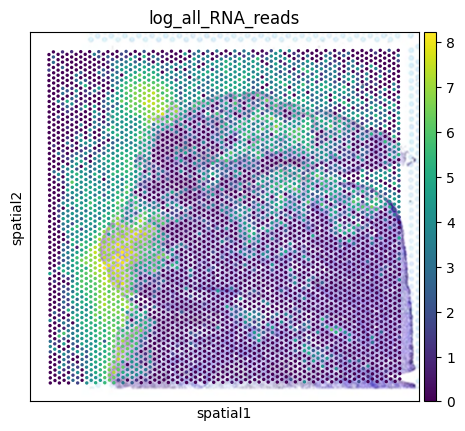

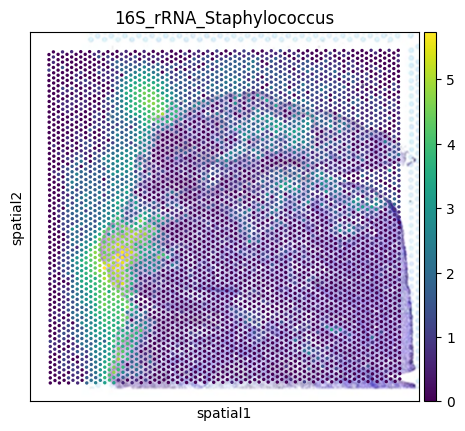

In [99]:
adata.obs['log_all_RNA_reads'] = np.log1p(adata.obs['all_RNA_reads'])
sc.pl.spatial(adata, color='log_all_RNA_reads')

sc.pl.spatial(adata, color='16S_rRNA_Staphylococcus')

tissue_positions_df = pd.read_csv('~/_Nature/CRC_16_human_16S_rRNA/outs/spatial/tissue_positions_list.csv')

In [100]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# in_tissue의 총 합을 계산합니다.
total_in_tissue = adata.obs['in_tissue'].sum()

# 조건을 만족하는 최소 이웃의 수를 찾기 위한 변수를 초기화합니다.
min_neighbors = 1
condition_met = False

# 조건을 만족할 때까지 이웃의 수를 증가시키면서 반복합니다.
for n_neighbors in range(1, len(adata.obs) + 1):
    # 각 샘플에 대해 n_neighbors 만큼의 가장 가까운 이웃을 찾습니다.
    nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:n_neighbors+1]

    # 새로운 플래그를 계산합니다.
    new_flag = []
    for idx, neighbors in enumerate(nearest_neighbors_indices):
        # 이웃들의 in_tissue 값 검사
        neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
        # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
        new_flag.append(np.any(neighbor_in_tissue == 1))

    # new_flag의 총 합을 계산합니다.
    total_new_flag = np.sum(new_flag)

    # 조건이 충족되는지 검사합니다.
    if total_new_flag >= 1.2 * total_in_tissue:
        min_neighbors = n_neighbors
        condition_met = True
        break

# 결과를 출력합니다.
if condition_met:
    print(f"최소 이웃의 수: {min_neighbors}, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.")
    # 새로운 플래그를 adata.obs에 추가합니다.
    adata.obs['new_flag'] = new_flag
else:
    print("어떤 이웃의 수에서도 new_flag의 총 합이 in_tissue의 1.2 배를 초과하지 않습니다.")


최소 이웃의 수: 70, 이 때 new_flag의 총 합은 in_tissue의 1.2 배 이상입니다.


In [101]:
from scipy.spatial import distance
import numpy as np

# array_row와 array_col을 기반으로 모든 샘플 간의 거리를 계산합니다.
min_neighbors = 70
coords = adata.obs[['array_row', 'array_col']].values
dist_matrix = distance.cdist(coords, coords, 'euclidean')

# 각 샘플에 대해 가장 가까운 3개의 이웃을 찾습니다 (자기 자신을 제외).
# argsort를 사용하여 각 행마다 거리가 가장 짧은 이웃의 인덱스를 얻습니다.
nearest_neighbors_indices = np.argsort(dist_matrix, axis=1)[:, 1:(min_neighbors+1)]

# in_tissue 값을 기반으로 새로운 플래그를 생성합니다.
# 이 플래그는 주어진 샘플이 이웃 중 하나 이상이 in_tissue가 1인 경우 true로 설정됩니다.
new_flag = []
for idx, neighbors in enumerate(nearest_neighbors_indices):
    # 이웃들의 in_tissue 값 검사
    neighbor_in_tissue = adata.obs.iloc[neighbors]['in_tissue'].values
    # 이웃 중 하나라도 in_tissue가 1이면, 해당 샘플의 플래그를 true로 설정
    new_flag.append(np.any(neighbor_in_tissue == 1))

# 새로운 플래그를 adata.obs에 추가
adata.obs['new_flag'] = new_flag

# 결과 확인
print(adata.obs[['array_row', 'array_col', 'in_tissue', 'new_flag']].head())

# 선택적으로, spatial plot 생성
#sc.pl.spatial(filtered_adata, color='new_flag')


                    array_row  array_col  in_tissue  new_flag
AAACAACGAATAGTTC-1          0         16          0     False
AAACAAGTATCTCCCA-1         50        102          1      True
AAACAATCTACTAGCA-1          3         43          1      True
AAACACCAATAACTGC-1         59         19          0     False
AAACAGAGCGACTCCT-1         14         94          1      True


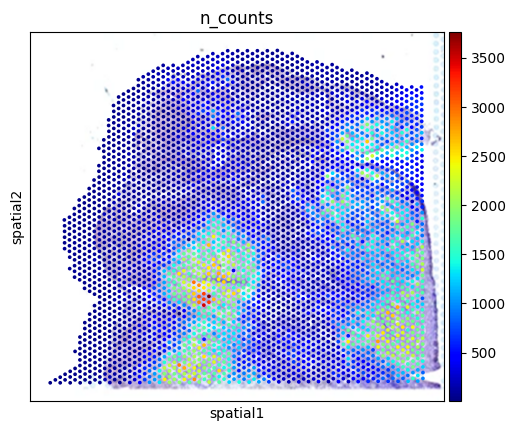

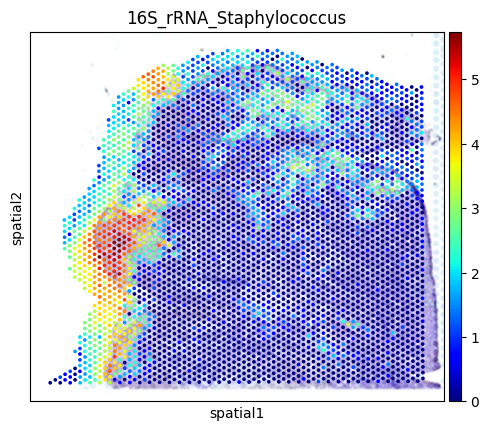

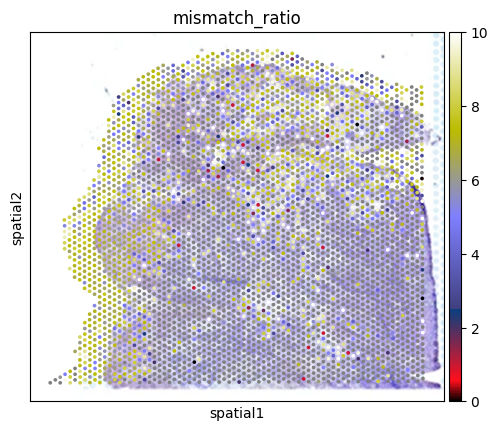

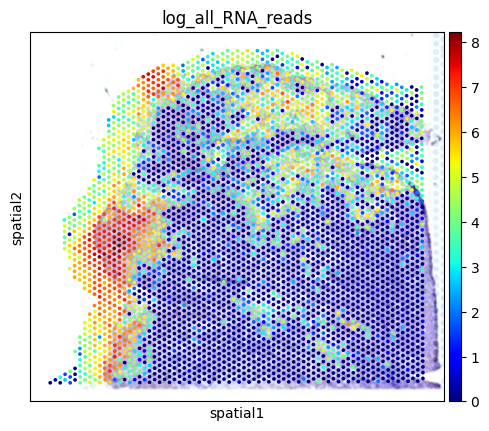

In [103]:
# 선택적으로, spatial plot 생성
# sc.pl.spatial(adata, color='new_flag')

filtered_adata = adata[adata.obs['new_flag'] == True]

sc.pl.spatial(filtered_adata, color = 'n_counts', cmap='jet')

sc.pl.spatial(filtered_adata, color = '16S_rRNA_Staphylococcus', cmap='jet')

import matplotlib.pyplot as plt
import scanpy as sc

cmap = plt.cm.gist_stern  # You can choose any other colormap
cmap.set_under('gray')  # Setting the color for -1 values

# Create the plot
sc.pl.spatial(filtered_adata, color='mismatch_ratio', cmap=cmap, vmax = 10, vmin=0, show=False)

# Save the figure in high resolution
plt.savefig('spatial_plot.png', dpi=300)  # 300 dpi is typically considered high resolution

sc.pl.spatial(filtered_adata, color = 'log_all_RNA_reads', cmap='jet')

In [66]:
# AnnData 객체를 'adata.h5ad' 파일로 저장
adata.write('CRC_filtered_adata_240410_staphylococcus.h5ad')


/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


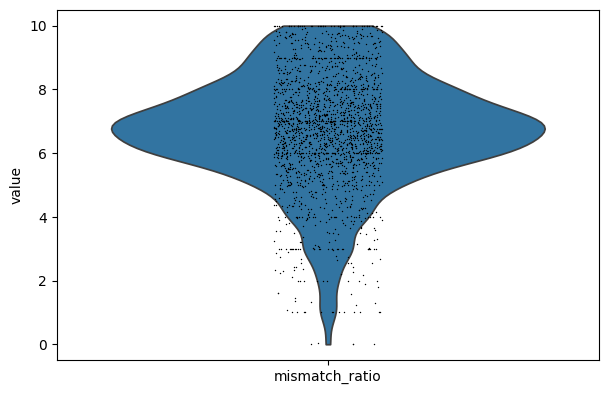

In [104]:
import scanpy as sc

# mismatch_ratio가 -1이 아닌 행만 필터링
filtered_data = filtered_adata[filtered_adata.obs['mismatch_ratio'] != -1].copy()

# 필터링된 데이터로 바이올린 플롯 그리기
sc.pl.violin(filtered_data, keys='mismatch_ratio')


In [106]:
import anndata

# h5ad 파일 로드
adata = anndata.read_h5ad('./CRC_filtered_adata_240410.h5ad')


In [108]:
adata.obs

,in_tissue,array_row,array_col,n_counts,mask,all_RNA_reads,mean_num_of_mismatches,mismatch_ratio,log_all_RNA_reads,new_flag
AAACAACGAATAGTTC-1,0,0,16,186.152924,Out,20,200,10.000000,3.044522,False
AAACAAGTATCTCCCA-1,1,50,102,349.157562,In,0,0,-1.000000,0.000000,True
AAACAATCTACTAGCA-1,1,3,43,1545.991211,In,40,246,6.150000,3.713572,True
AAACACCAATAACTGC-1,0,59,19,62.473984,Out,201,1168,5.810945,5.308268,False
AAACAGAGCGACTCCT-1,1,14,94,341.236755,In,0,0,-1.000000,0.000000,True
...,...,...,...,...,...,...,...,...,...,...
TTGTTTCACATCCAGG-1,0,58,42,65.193329,Out,0,0,-1.000000,0.000000,True
TTGTTTCATTAGTCTA-1,0,60,30,43.600410,Out,29,200,6.896552,3.401197,True
TTGTTTCCATACAACT-1,1,45,27,171.439590,In,0,0,-1.000000,0.000000,True
TTGTTTGTATTACACG-1,0,73,41,38.188763,Out,13,95,7.307692,2.639057,False


## VIOLIN PLOT

/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.

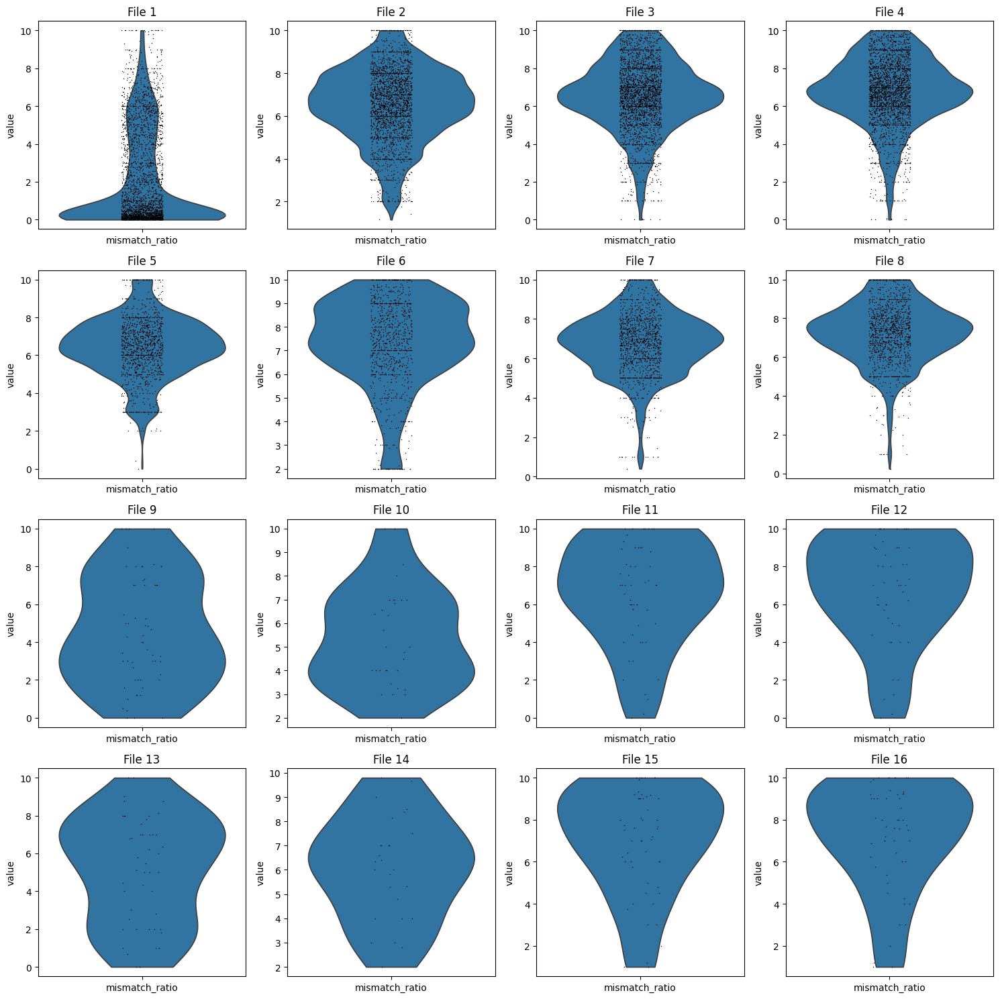

In [2]:
import anndata
import scanpy as sc
import matplotlib.pyplot as plt

# 파일 이름 리스트 초기화
file_names = ['/home/seohyepark/_Nature/CRC_filtered_adata_240410_escherichia.h5ad', '/home/seohyepark/_Nature/CRC_filtered_adata_240410.h5ad', '/home/seohyepark/_Nature/CRC_filtered_adata_240410_staphilococcus.h5ad','/home/seohyepark/_Nature/CRC_filtered_adata_240410_staphylococcus.h5ad',
              '/home/seohyepark/_Nature/OSCC_filtered_adata_escherichia_240409.h5ad','/home/seohyepark/_Nature/OSCC_filtered_adata_240409.h5ad','/home/seohyepark/_Nature/OSCC_filtered_adata_Staphilococcus_240409.h5ad','/home/seohyepark/_Nature/OSCC_filtered_adata_Staphylococcus_240409.h5ad',
              '/home/seohyepark/portrai-nadim/2831300_filtered_adata_240409_escherichia.h5ad','/home/seohyepark/portrai-nadim/2831300_filtered_adata_240409_chlamidia.h5ad','/home/seohyepark/portrai-nadim/2831300_filtered_adata_240409_staphilococcus.h5ad','/home/seohyepark/portrai-nadim/2831300_filtered_adata_240409_staphylococcus.h5ad',
              '/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_escherichia.h5ad','/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_chlamidia.h5ad','/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_staphilococcus.h5ad','/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_staphylococcus.h5ad']

# 4x4 그리드로 플롯 생성
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 15))

for idx, file_name in enumerate(file_names):
    # 파일 로드
    adata = anndata.read_h5ad(file_name)

    # mismatch_ratio가 -1이 아닌 행만 필터링
    filtered_adata = adata[adata.obs['mismatch_ratio'] != -1]

    # 현재 서브플롯 위치 계산
    row = idx // 4
    col = idx % 4

    # 바이올린 플롯 그리기
    sc.pl.violin(filtered_adata, keys='mismatch_ratio', ax=axes[row, col], show=False)

    # 서브플롯에 제목 추가 (옵션)
    axes[row, col].set_title(f'File {idx+1}')

# 전체 플롯의 레이아웃 조정
plt.tight_layout()

# 플롯 표시
plt.show()


/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/seohyepark/yes/envs/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.

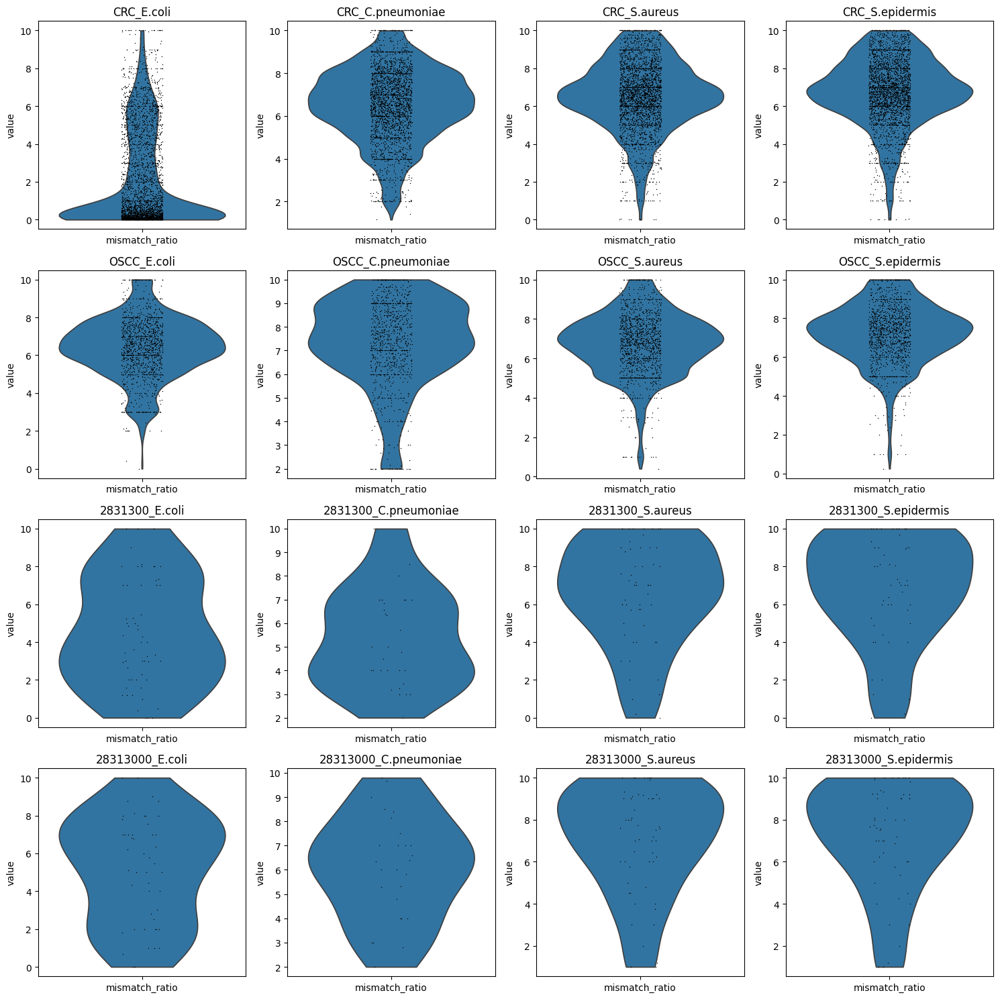

In [5]:
import anndata
import scanpy as sc
import matplotlib.pyplot as plt

# 파일 이름 리스트 초기화 (경로는 예시로 제공됨)
file_names = ['/home/seohyepark/_Nature/CRC_filtered_adata_240410_escherichia.h5ad', '/home/seohyepark/_Nature/CRC_filtered_adata_240410.h5ad', '/home/seohyepark/_Nature/CRC_filtered_adata_240410_staphilococcus.h5ad','/home/seohyepark/_Nature/CRC_filtered_adata_240410_staphylococcus.h5ad',
              '/home/seohyepark/_Nature/OSCC_filtered_adata_escherichia_240409.h5ad','/home/seohyepark/_Nature/OSCC_filtered_adata_240409.h5ad','/home/seohyepark/_Nature/OSCC_filtered_adata_Staphilococcus_240409.h5ad','/home/seohyepark/_Nature/OSCC_filtered_adata_Staphylococcus_240409.h5ad',
              '/home/seohyepark/portrai-nadim/2831300_filtered_adata_240410_escherichia.h5ad','/home/seohyepark/portrai-nadim/2831300_filtered_adata_240410_chlamydia.h5ad','/home/seohyepark/portrai-nadim/2831300_filtered_adata_240409_staphilococcus.h5ad','/home/seohyepark/portrai-nadim/2831300_filtered_adata_240409_staphylococcus.h5ad',
              '/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_escherichia.h5ad','/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_chlamidia.h5ad','/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_staphilococcus.h5ad','/home/seohyepark/portrai-nadim/28313000_filtered_adata_240409_staphylococcus.h5ad']

# 각 파일에 대한 제목 리스트
titles = [
    "CRC_E.coli", "CRC_C.pneumoniae", "CRC_S.aureus", "CRC_S.epidermis",
    "OSCC_E.coli", "OSCC_C.pneumoniae", "OSCC_S.aureus", "OSCC_S.epidermis",
    "2831300_E.coli", "2831300_C.pneumoniae", "2831300_S.aureus", "2831300_S.epidermis",
    "28313000_E.coli", "28313000_C.pneumoniae", "28313000_S.aureus", "28313000_S.epidermis"
]

# 4x4 그리드로 플롯 생성
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 15))

for idx, (file_name, title) in enumerate(zip(file_names, titles)):
    # 파일 로드
    adata = anndata.read_h5ad(file_name)

    # mismatch_ratio가 -1이 아닌 행만 필터링
    filtered_adata = adata[adata.obs['mismatch_ratio'] != -1]

    # 현재 서브플롯 위치 계산
    row = idx // 4
    col = idx % 4

    # 바이올린 플롯 그리기
    sc.pl.violin(filtered_adata, keys='mismatch_ratio', ax=axes[row, col], show=False)

    # 서브플롯에 제목 설정
    axes[row, col].set_title(title)

# 전체 플롯의 레이아웃 조정
plt.tight_layout()

# 플롯 표시
plt.show()
